In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.path as mpath
from matplotlib import rc
import matplotlib.pyplot as plt
import netCDF4 as nc 
import pandas as pd 
import xarray as xr
import seaborn as sns
import scipy
import dask
import h5py
from xgcm import Grid
import matplotlib.animation as animation
from IPython.display import HTML
from PIL import Image
from cycler import cycler
import cmocean
from matplotlib.colors import TwoSlopeNorm
np.random.seed(4321)
plt.rcParams.update({'font.size': 10})
mpl.rcParams['animation.embed_limit'] = 2**128
print('all done')
%matplotlib inline
nanmasked = plt.get_cmap('cmo.haline').copy()
nanmasked.set_bad('black')
nanmasked2 = plt.get_cmap('cmo.balance').copy()
nanmasked2.set_bad('black')

all done


### Loading z coordinate data + static grid data

In [3]:
### loading in year 1993 dye experiments
data_path = '/scratch/gpfs/CDEUTSCH/wchu/CEFI-regional-MOM6/exps/NWA12.COBALT/OUTPUT/combined/control-budget-dye-1993/19930101.dye_experiments_z_1993_'
ds = xr.concat([xr.open_dataset(data_path+'{:02}'.format(i)+'.nc',chunks='auto') for i in range(1, 13)],dim='time')
ds=ds.rename({'xh_sub01': 'xh','yh_sub01':'yh'})

# data_path = '/scratch/gpfs/CDEUTSCH/wchu/CEFI-regional-MOM6/exps/NWA12.COBALT/OUTPUT/combined/control-budget-dye-1993/19930101.ocean_daily_budgets_1993_'
# ds = xr.concat([xr.open_dataset(data_path+'{:02}'.format(i)+'.nc',chunks='auto') for i in range(1, 12)],dim='time')
# ds = ds.rename({'xh_sub01': 'xh','yh_sub01': 'yh'})

### full static on the native full grid cropped to region
data_path = '/scratch/gpfs/CDEUTSCH/wchu/CEFI-regional-MOM6/exps/NWA12.COBALT/OUTPUT/combined/control-budget-dye-1993-native/19930101.ocean_static.nc'
static = xr.open_dataset(data_path,chunks='auto')
static = static.isel(xh=slice(0,601),yh=slice(0,343),xq=slice(0,601),yq=slice(0,343))

### need to figure out why the coordinates are being weird but for now just reassign to static
# ds = ds.rename({'xh_sub01': 'xh','yh_sub01':'yh','xq_sub01': 'xq','yq_sub01':'yq','xh_sub02': 'xh2','yh_sub02':'yh2'})
# ds = ds.assign_coords(xh=static.xh)
# ds = ds.assign_coords(yh=static.yh)
# ds = ds.assign_coords(xq=static.xq)
# ds = ds.assign_coords(yq=static.yq)
# ds = ds.assign_coords(xh2=static.xh)
# ds = ds.assign_coords(yh2=static.yh)
# ds = xr.merge([ds, static]) # merge them to be convenient for xgrid

In [7]:
static.xh[598:602]

<xarray.DataArray 'xh' (xh: 3)> Size: 24B
array([-50.160004, -50.079987, -50.      ])
Coordinates:
  * xh       (xh) float64 24B -50.16 -50.08 -50.0
Attributes:
    units:      degrees_east
    long_name:  h point nominal longitude
    axis:       X

In [4]:
### defining xgcm grid for best practices 

# static['dzt'] = xr.DataArray(data=ds['z_i'].diff('z_i').values,
#                          coords={'z_l': ds['z_l']},
#                          dims=('z_l'))

static['dxt'] = static['dxt'].fillna(0.)
static['dyt'] = static['dyt'].fillna(0.)
# static['dzt'] = static['dzt'].fillna(0.)
static['areacello'] = static['areacello'].fillna(0.)
# static['volcello'] = ds['volcello'].fillna(0.)

metrics = {
    ('X',): ['dxt'], # X distances
    ('Y',): ['dyt'], # Y distances
    # ('Z',): ['dzt'],
    ('X', 'Y'): ['areacello'], # Areas
    # ('X', 'Y', 'Z'): ['volcello'], # Volumes
}

coords={'X': {'center': 'xh', 'right': 'xq'},
        'Y': {'center': 'yh', 'right': 'yq'}}
        # 'Z': {'center': 'z_l', 'outer': 'z_i'}}

grid = Grid(static, coords=coords, metrics=metrics) # not periodic because it's a regional model, periodic=['X'])

### Dye plotting

Helper functions

In [5]:
def xz_sec(var,lat,time_ind,depths,native):
    # plots the vertical section against longitude of some variable
    # var is the variable you want to plot, i.e. "dye50m"
    # lat is the desired latitude transect (number), i.e. 23.5
    # time_ind is the index of time you want to plot, i.e. 30
    # depths is the vertical extent of the plot [m] in tuple form, i.e. (20, 1000) 
    # native is to specify whether we need to add fake topography for native coords, i.e. "z" for z-grid, "n" for native
    # mld is to specify whether you want to add mld depth in red, i.e. "mld" for mld or some other string for no mld (not used bc mld not output on z grid)
    # example use case: xz_sec("dye50m",23.5,30,(20,1000),"z","mld")
    fig, ax = plt.subplots(1, 1, figsize=(18,4))
    if native=="z":
        # on z grid
        ds[var].isel(time=time_ind).sel(yh=lat,method='nearest').sel(**{'z_l': slice(*depths)}).plot(x='xh',y='z_l',cmap=nanmasked,ax=ax,vmin=0,vmax=0.8)
    elif native=="n":
        # on native grid
        ds[var].isel(time=time_ind).sel(yh=lat,method='nearest').sel(**{'zl': slice(*depths)}).plot(x='xh',y='zl',cmap=nanmasked,ax=ax,vmin=0,vmax=0.8)
        ax.fill_between(ds.xh,static.depth_ocean.sel(yh=lat,method="nearest"),max_depth*np.ones(601),color='black') # fake topography since we're in native coordinates
    # if mld==1:
    #     # plot MLD
    #     ds.MLD_003.isel(time=time_ind).sel(yh=lat,method='nearest').plot(x='xh',color='red',ax=ax)
    ax.invert_yaxis()
    plt.show()
    
def yz_sec(var,lon,time_ind,depths,native):
    # plots the vertical section of some variable
    # var is the variable you want to plot, i.e. "dye50m"
    # lat is the desired latitude transect (number), i.e. 23.5
    # time_ind is the index of time you want to plot, i.e. 30
    # depths is the vertical extent of the plot [m] in tuple form, i.e. (20, 1000) 
    # native is to specify whether we need to add fake topography for native coords, i.e. "z" for z-grid, "n" for native
    # mld is to specify whether you want to add mld depth in red, i.e. "mld" for mld or some other string for no mld (not used bc mld not output on z grid)
    # example use case: yz_sec("dye50m",23.5,30,(20,1000),"z","mld")
    fig, ax = plt.subplots(1, 1, figsize=(18,4))
    if native=="z":
        # on z grid
        ds[var].isel(time=time_ind).sel(xh=lon,method='nearest').sel(**{'z_l': slice(*depths)}).plot(x='yh',y='z_l',cmap=nanmasked,ax=ax,vmin=0,vmax=0.8)
    elif native=="n":
        # on native grid
        ds[var].isel(time=time_ind).sel(xh=lon,method='nearest').sel(**{'zl': slice(*depths)}).plot(x='yh',y='zl',cmap=nanmasked,ax=ax,vmin=0,vmax=0.8)
        ax.fill_between(ds.yh,static.depth_ocean.sel(xh=lon,method="nearest"),max_depth*np.ones(343),color='black') # fake topography since we're in native coordinates
    ax.invert_yaxis()
    plt.show()

dye50m is done
dye100m is done
dye200m is done
dye400m is done
dye800m is done
dye1600m is done
dye3200m is done


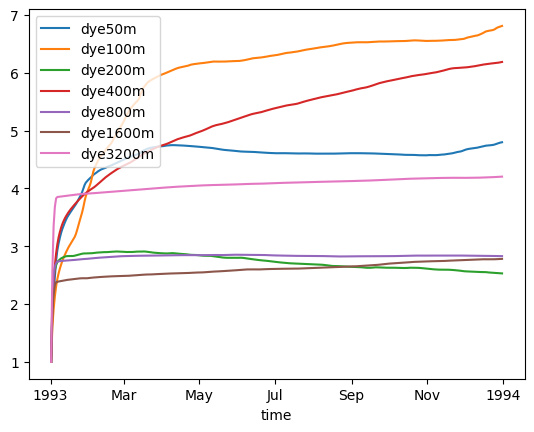

In [82]:
# yz_sec("dye50m",-60,360,(0,270),"z")

# dyes = ['dye50m','dye100m','dye200m','dye400m','dye800m','dye1600m','dye3200m']
sums = []
for dye in dyes:
    sums.append(grid.integrate(ds[dye],['X','Y']).sum('z_l')/grid.integrate(ds[dye].isel(time=0),['X','Y']).sum('z_l'))
    print(dye + ' is done')

for dye in sums:
    dye.plot(x='time')
    
plt.legend(dyes)

# ds.dye100m.sum(['xh','yh','z_l']).plot(x='time')

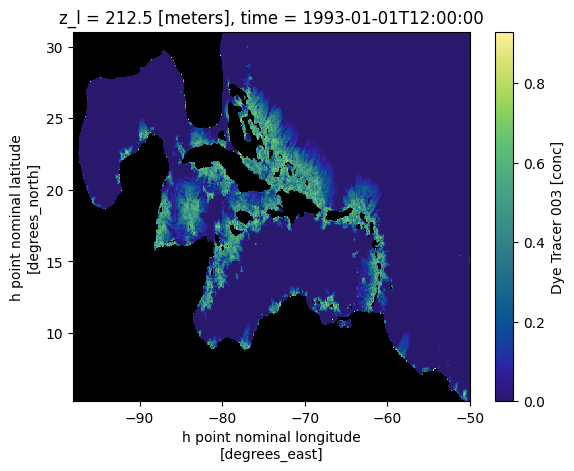

In [18]:
ds.dye200m.isel(time=0,z_l=22).plot(x='xh',y='yh',cmap=nanmasked)

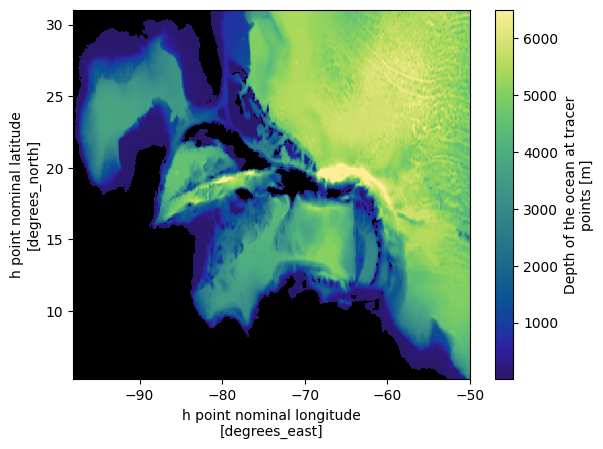

In [19]:
static.depth_ocean.plot(x='xh',y='yh',cmap=nanmasked)

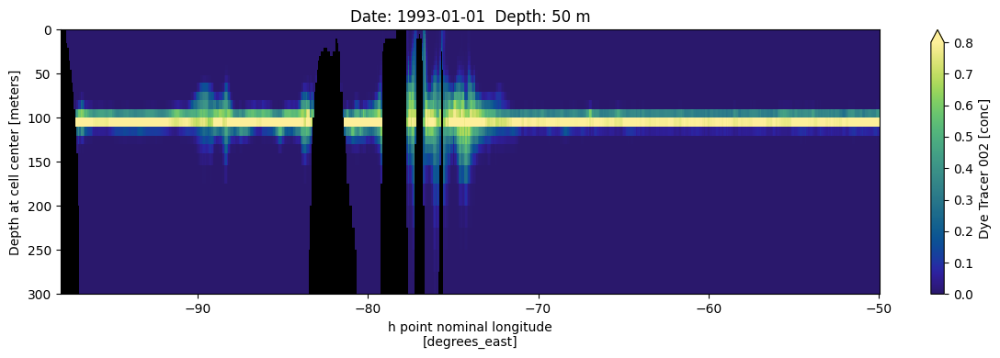

In [19]:
lat=24.5
fig, ax = plt.subplots(1, 1, figsize=(12,4))
dye400 = ds["dye100m"].isel(time=0).sel(yh=lat,method='nearest').sel(**{'z_l': slice(0,300)}).plot(x='xh',y='z_l',cmap=nanmasked,ax=ax,vmin=0,vmax=0.8)
ax.invert_yaxis()
    
def animate(frame):
    dye400.set_array(ds["dye100m"].isel(time=frame).sel(yh=lat,method='nearest').sel(**{'z_l': slice(0,300)}))
    ax.set_title(label='Date: ' + ds.time[frame].dt.strftime('%Y-%m-%d').values + '  Depth: 50 m')
    plt.tight_layout()

ani = animation.FuncAnimation(fig, animate, frames=365)
# ani.save('/scratch/gpfs/CDEUTSCH/wchu/images/coral_extremes.gif', writer='imagemagick', fps = 4) #Save animation as gif-file

HTML(ani.to_jshtml())

### Dye horizontal maps

In [ ]:
# ### horizontal plot
# time_ind=4
# fig, ax = plt.subplots(1, 1, figsize=(9,4))
# # ds.boundary_impulse.isel(time=time_ind).sel(zl=50,method='nearest').plot(x='xh',y='yh',cmap=nanmasked,ax=ax)
# # .sel(**{'xh': slice(-63.5, -60.5)},**{'yh': slice(10, 13)})
# ds.dye002.isel(time=time_ind).sel(zl=200,method='nearest').plot(x='xh',y='yh',cmap=nanmasked,ax=ax)
# ax.set_aspect('equal')